In [1]:

import torch
import torch.nn.functional as F
from models import Create_nets
from datasets import Get_dataloader
#from options import TrainOptions
from torchvision import models
import os
from PIL import Image
import torchvision.transforms.functional as TF
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

#args = TrainOptions().parse() # surpass kernelerror with this:

class TrainOptions:
    def __init__(self):
        self.exp_name = "Exp0-r18"
        self.epoch_start = 0
        self.epoch_num = 150
        self.factor = 1
        self.seed = 233
        self.num_row = 4
        self.activation = 'gelu'
        self.unalign_test = False
        self.data_root = '/home/bule/projects/datasets/mvtec_anomaly_detection/'
        self.dataset_name = "cable"
        self.batch_size = 2
        self.lr = 1e-4
        self.b1 = 0.5
        self.b2 = 0.999
        self.n_cpu = 8
        self.image_result_dir = 'result_images'
        self.model_result_dir = 'saved_models'
        self.validation_image_dir = 'validation_images'

# Example of how to use this class
args = TrainOptions()

torch.manual_seed(args.seed)

In [2]:
## laod a saved model to inspect 

category= "cable"
SAVE_PATH='./inspects'

## Load Pretrained  Trafo model
transformer = Create_nets(args).to(device)
checkpoint = torch.load(f'./Exp0-r18-{category}/saved_models/checkpoint.pth')
transformer.load_state_dict(checkpoint['transformer'])
#print(transformer)

# Backbone hooks
backbone = models.resnet18(pretrained=True).to(device)
backbone.eval()
outputs = []
def hook(module, input, output):
    outputs.append(output)
backbone.layer1[-1].register_forward_hook(hook)
backbone.layer2[-1].register_forward_hook(hook)
backbone.layer3[-1].register_forward_hook(hook)

def embedding_concat(x, y):
    B, C1, H1, W1 = x.size()
    _, C2, H2, W2 = y.size()
    s = int(H1 / H2)
    x = F.unfold(x, kernel_size=s, dilation=1, stride=s)
    x = x.view(B, C1, -1, H2, W2)
    z = torch.zeros(B, C1 + C2, x.size(2), H2, W2).to(device)
    for i in range(x.size(2)):
        z[:, :, i, :, :] = torch.cat((x[:, :, i, :, :], y), 1)
    z = z.view(B, -1, H2 * W2)
    z = F.fold(z, kernel_size=s, output_size=(H1, W1), stride=s)
    return z

def load_image(filename,crop_size=256,aligned=True, img_size=280):
        img = Image.open(filename)
        img = img.convert('RGB')
        
        if aligned:
            img = TF.resize(img, crop_size, Image.BICUBIC)
            img = TF.to_tensor(img)
            img = TF.normalize(img, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225 ])
        else:
            img = TF.resize(img, img_size, Image.BICUBIC)
            angle = transforms.RandomRotation.get_params([-10, 10])
            img = TF.rotate(img, angle, fill=(0,))
            i, j, h, w = transforms.RandomCrop.get_params(img, output_size=(crop_size, crop_size))
            img = TF.crop(img, i, j, h, w)
            img = TF.to_tensor(img)
            img = TF.normalize(img, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225 ])    
            img=img.to(torch.float32)
        return img
    
def plot_images(images):
    num_images = images.shape[0]
    num_rows = int(num_images ** 0.5)
    num_cols = num_images // num_rows
    fig, axes = plt.subplots(nrows=num_rows, ncols=num_cols, figsize=(20, 20))
    for i, ax in enumerate(axes.flat):
        ax.imshow(images[i], cmap='viridis')
        ax.axis('off')
    plt.subplots_adjust(wspace=0.01, hspace=0.05)  # Adjust the spacing between subplots
    plt.show()

/home/bule/anaconda3/envs/ultrad/lib/python3.9/site-packages/torch/nn/modules/transformer.py:282: UserWarning: enable_nested_tensor is True, but self.use_nested_tensor is False because encoder_layer.self_attn.batch_first was not True(use batch_first for better inference performance)
  warnings.warn(f"enable_nested_tensor is True, but self.use_nested_tensor is False because {why_not_sparsity_fast_path}")


/home/bule/anaconda3/envs/ultrad/lib/python3.9/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/bule/anaconda3/envs/ultrad/lib/python3.9/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


 define some images for ineference

In [3]:
good_img_train_path = os.path.join(args.data_root,f'{category}/train/good/000.png') 
good_img_test_path = os.path.join(args.data_root,f'{category}/test/good/000.png')
anomaly_img_test_path = os.path.join(args.data_root,f'{category}/test/bent_wire/000.png')


In [4]:
path_list=[good_img_train_path,good_img_test_path,anomaly_img_test_path]
img_list=[load_image(path) for path in path_list]

featuremaps=[]
recons=[]
with torch.no_grad():
    for img in img_list:
        img=img.unsqueeze(0).to(device)
        outputs = []
        _ = backbone(img)  
        outputs = embedding_concat(embedding_concat(outputs[0],outputs[1]),outputs[2])
        recon, std = transformer(outputs)
        featuremaps.append(outputs)
        recons.append(recon)

resdict={'paths':path_list,'featuremaps':featuremaps,'recons':recons}

## Inspect results

Original images

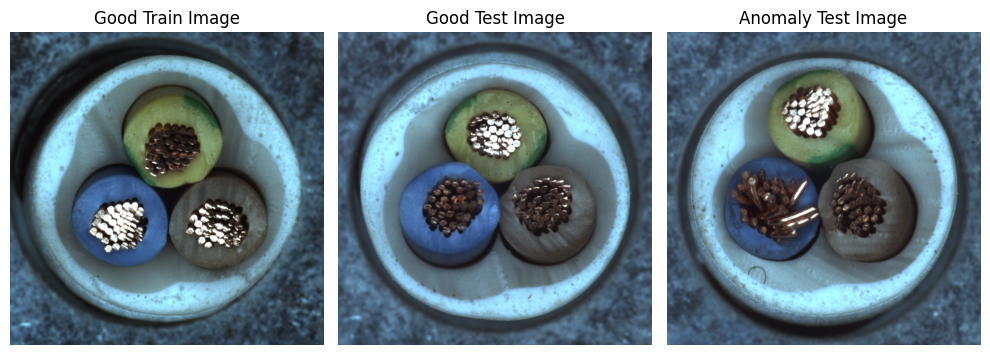

(None, None)

In [5]:
fig, axes = plt.subplots(1, 3, figsize=(10, 4))
axes[0].imshow(Image.open(resdict['paths'][0]))
axes[0].set_title('Good Train Image')
axes[0].axis('off')
axes[1].imshow(Image.open(resdict['paths'][1]))
axes[1].set_title('Good Test Image')
axes[1].axis('off')
axes[2].imshow(Image.open(resdict['paths'][2]))
axes[2].set_title('Anomaly Test Image')
axes[2].axis('off')
plt.tight_layout(),plt.show()

In [ ]:
## TODO fmaps for differnet levels

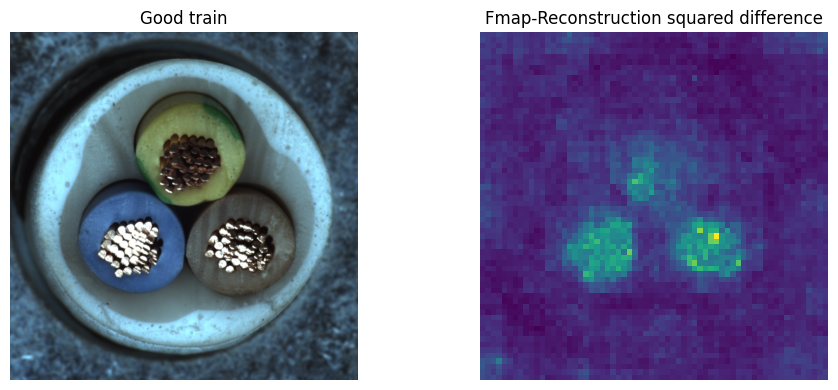

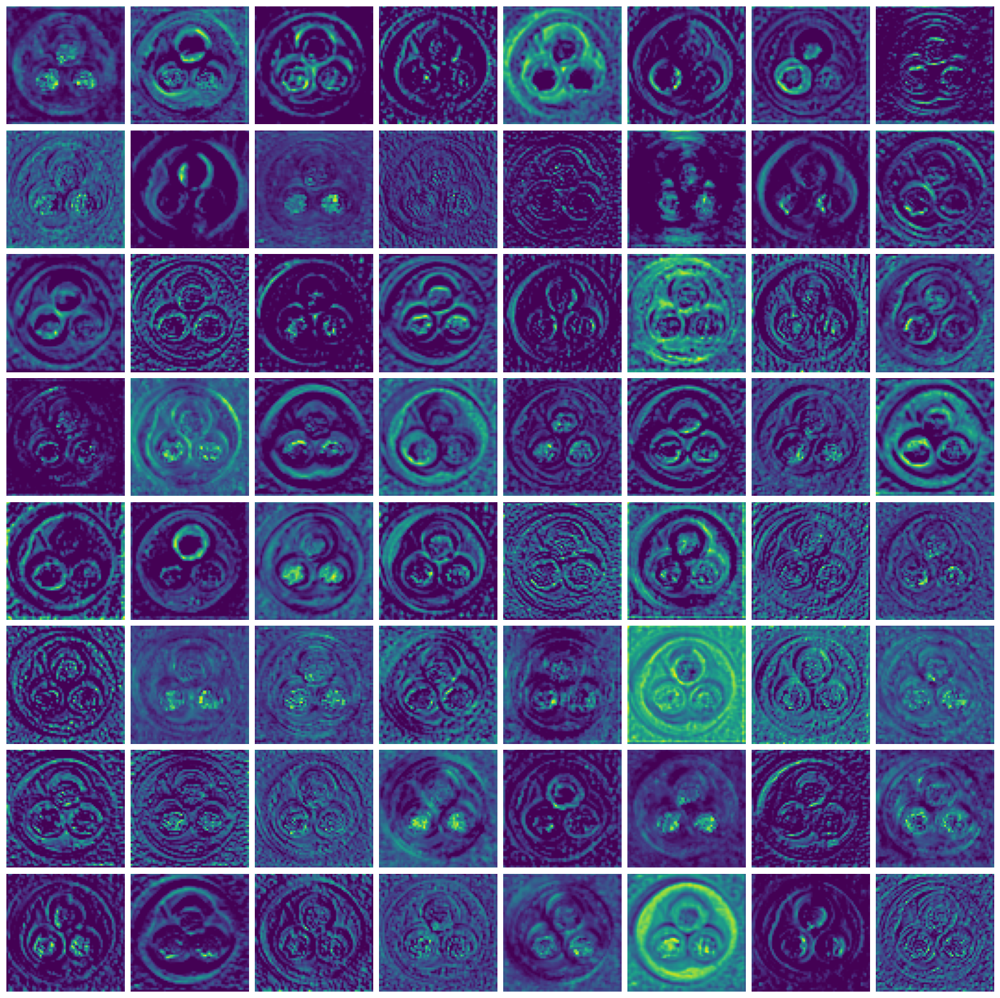

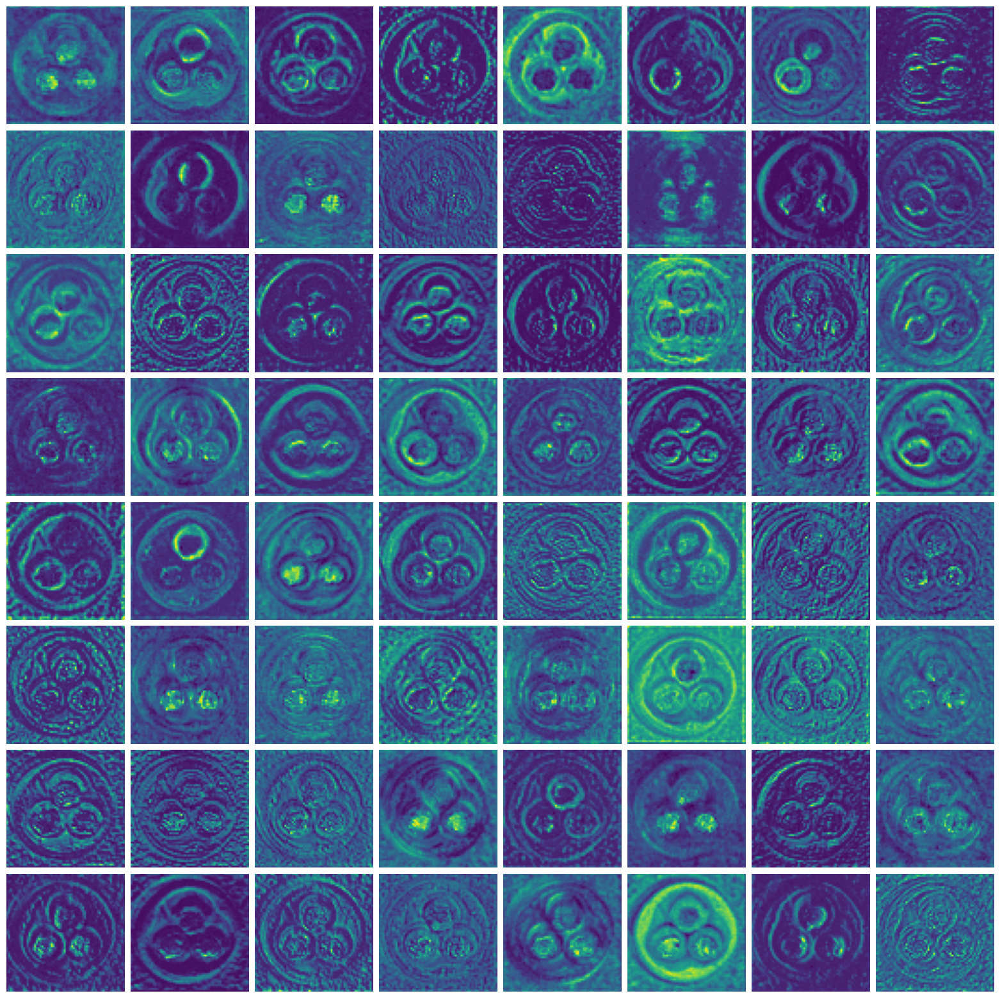

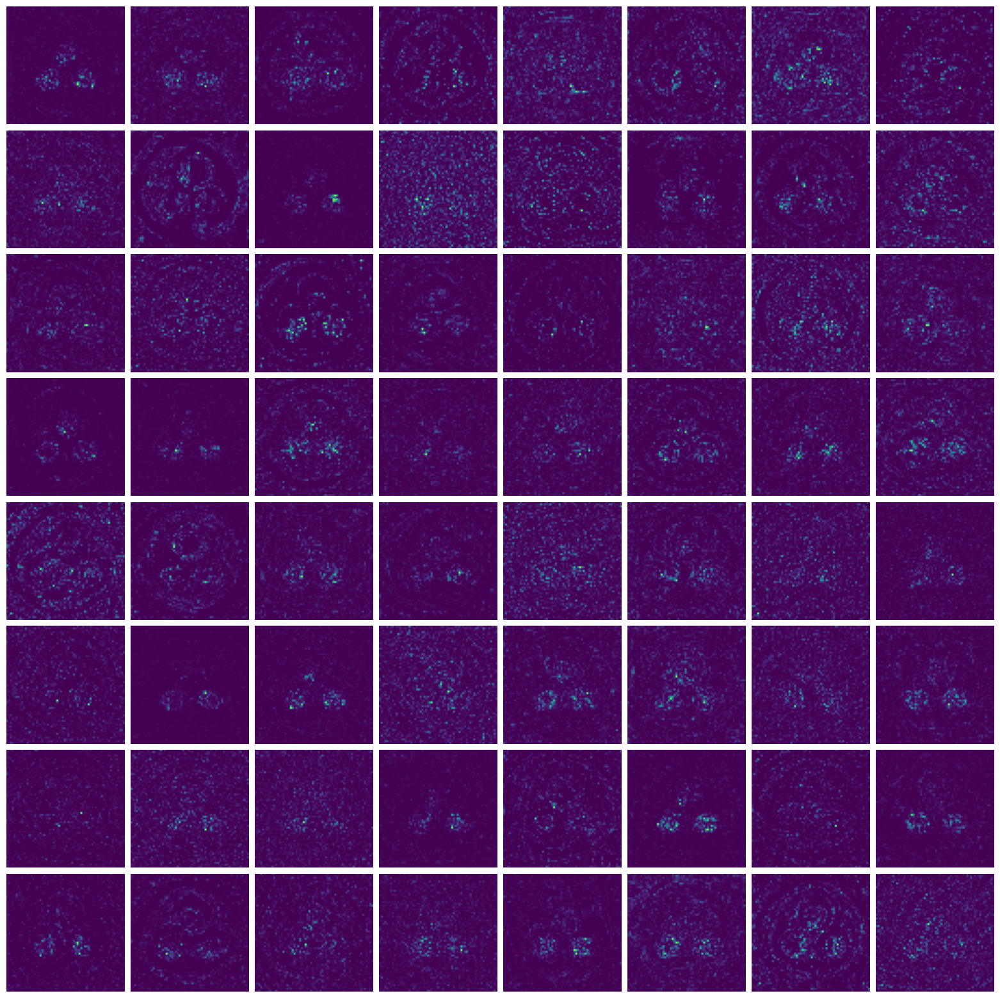

In [16]:
squared_diff=(resdict['featuremaps'][0][:,:,:,:].squeeze().cpu().numpy()-resdict['recons'][0][:,:,:,:].squeeze().cpu().numpy())**2
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].imshow(Image.open(resdict['paths'][0]))
axes[0].set_title('Good train')
axes[0].axis('off')
axes[1].imshow(sum(squared_diff))
axes[1].set_title('Fmap-Reconstruction squared difference')
axes[1].axis('off')
plt.tight_layout(),plt.show()

plot_images(resdict['featuremaps'][0][:,:64:,:,:].squeeze().cpu().numpy())
plot_images(resdict['recons'][0][:,:64,:,:].squeeze().cpu().numpy())
plot_images((resdict['featuremaps'][0][:,:64,:,:].squeeze().cpu().numpy()-resdict['recons'][0][:,:64,:,:].squeeze().cpu().numpy())**2)

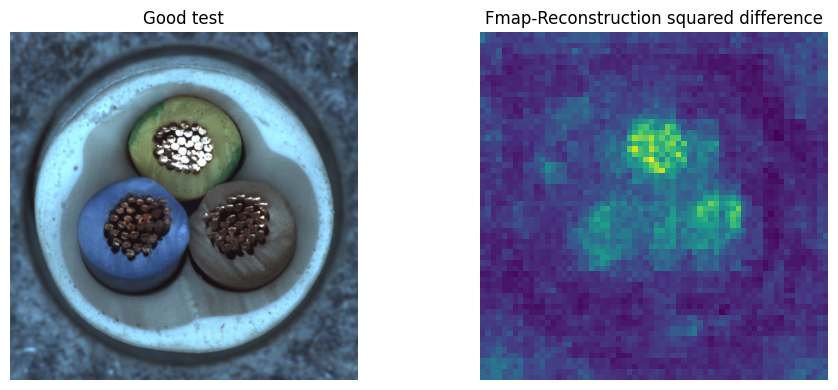

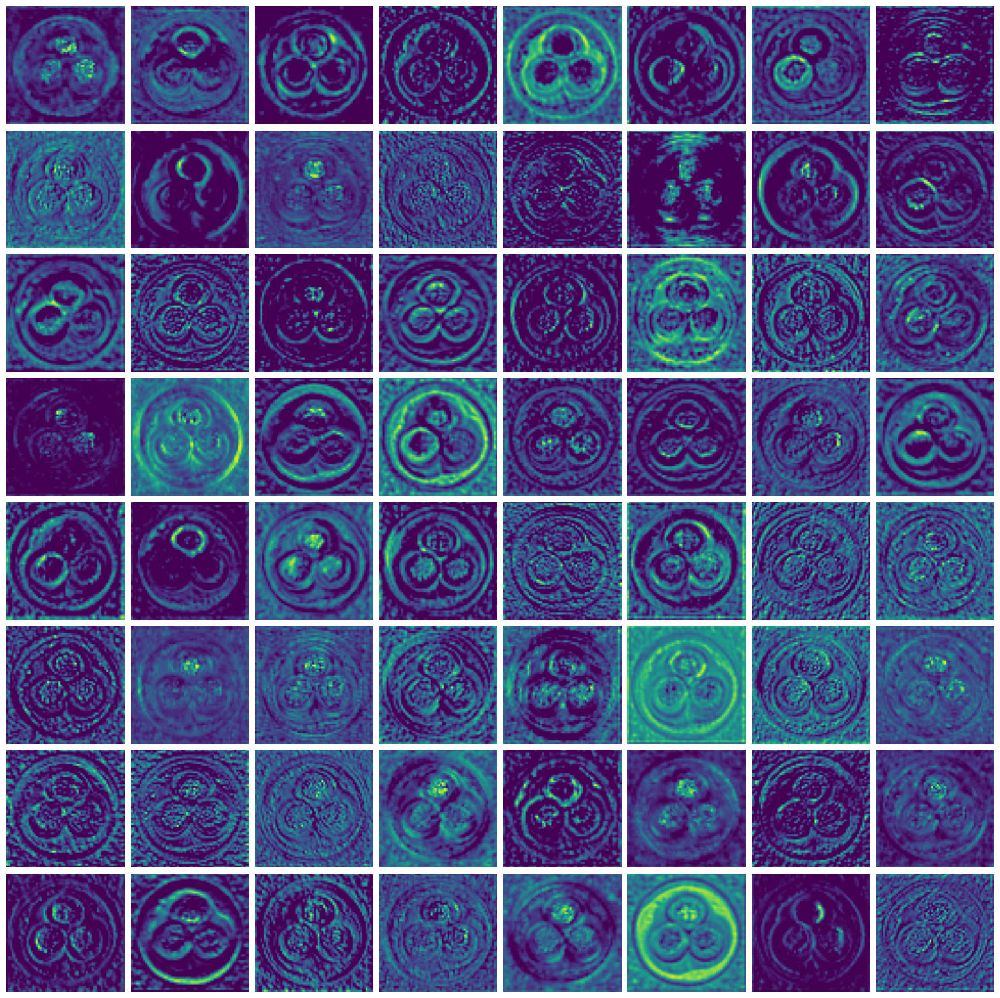

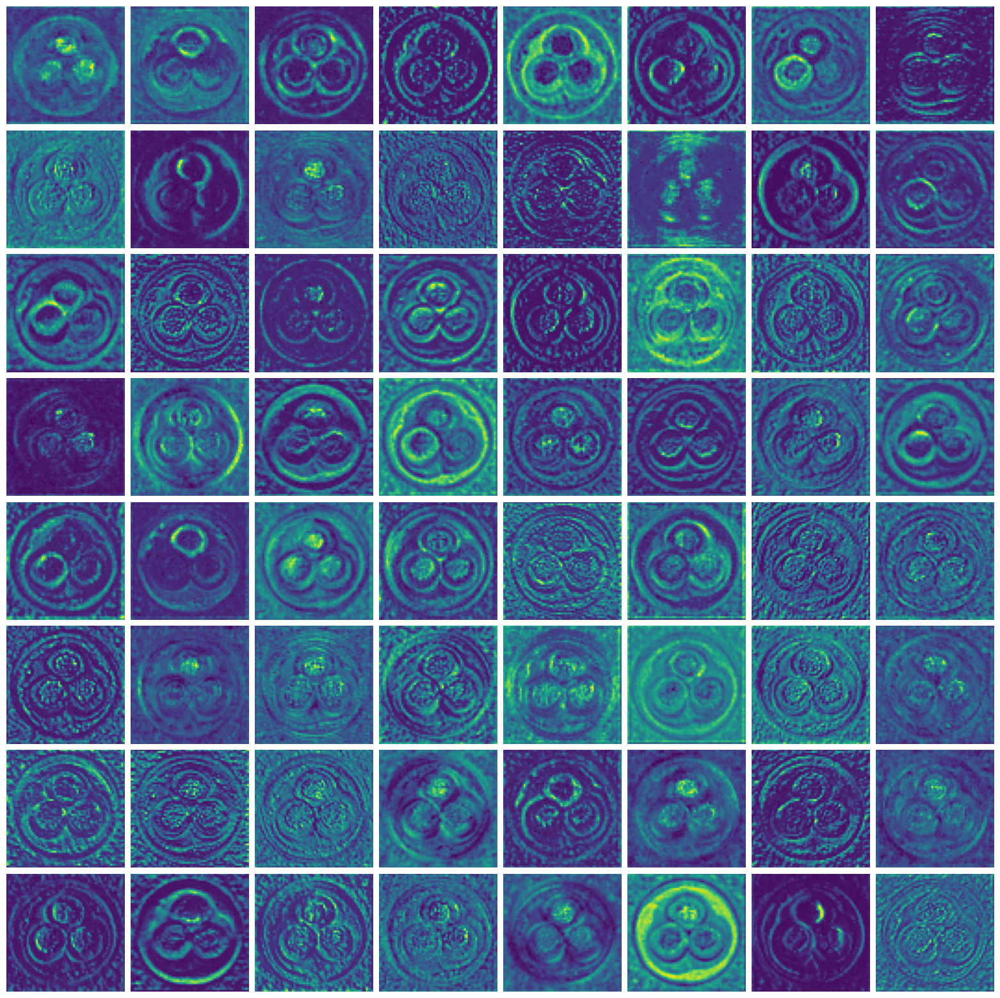

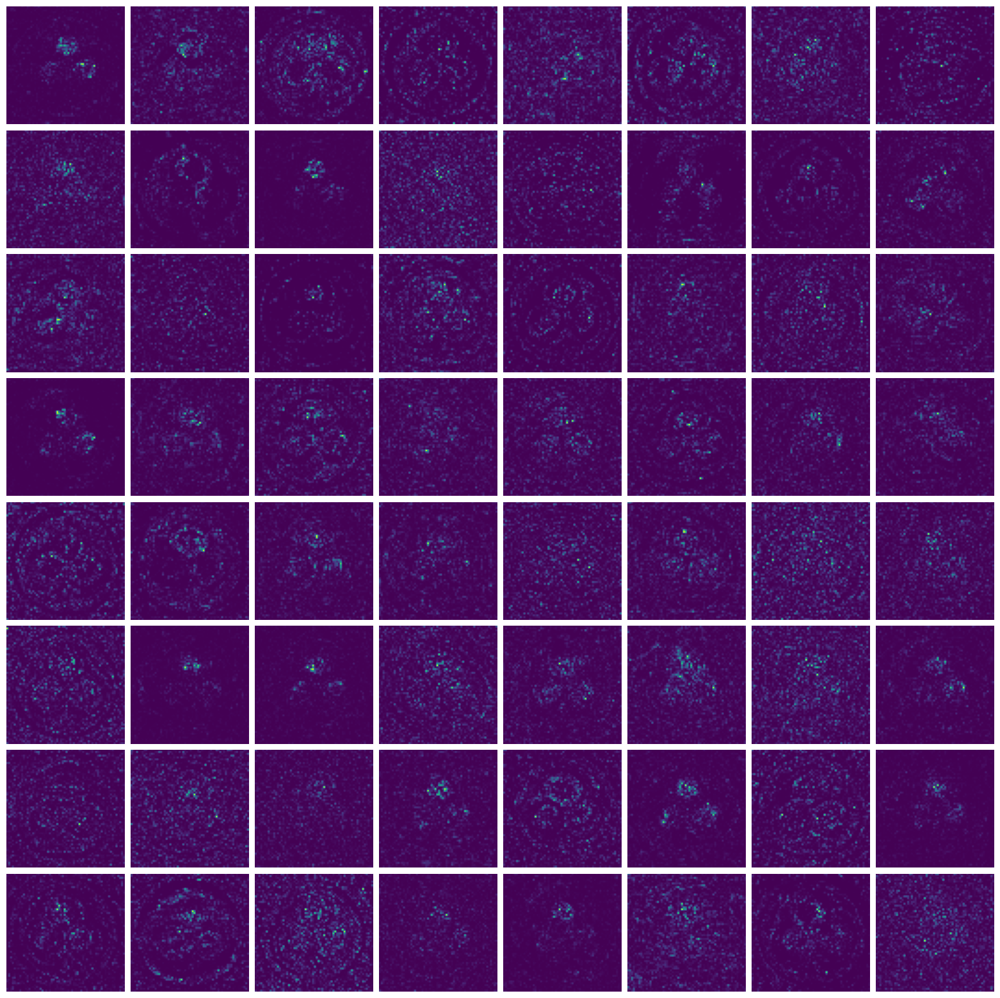

In [17]:
squared_diff=(resdict['featuremaps'][1][:,:,:,:].squeeze().cpu().numpy()-resdict['recons'][1][:,:,:,:].squeeze().cpu().numpy())**2
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].imshow(Image.open(resdict['paths'][1]))
axes[0].set_title('Good test')
axes[0].axis('off')
axes[1].imshow(sum(squared_diff))
axes[1].set_title('Fmap-Reconstruction squared difference')
axes[1].axis('off')
plt.tight_layout(),plt.show()

plot_images(resdict['featuremaps'][1][:,:64,:,:].squeeze().cpu().numpy())
plot_images(resdict['recons'][1][:,:64,:,:].squeeze().cpu().numpy())
plot_images((resdict['featuremaps'][1][:,:64,:,:].squeeze().cpu().numpy()-resdict['recons'][1][:,:64,:,:].squeeze().cpu().numpy())**2)

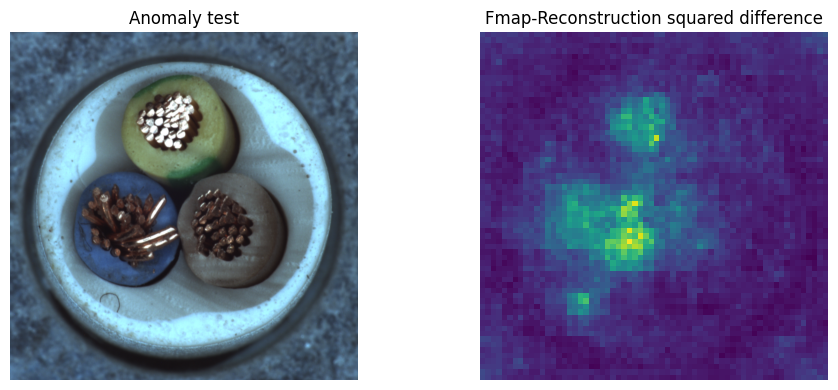

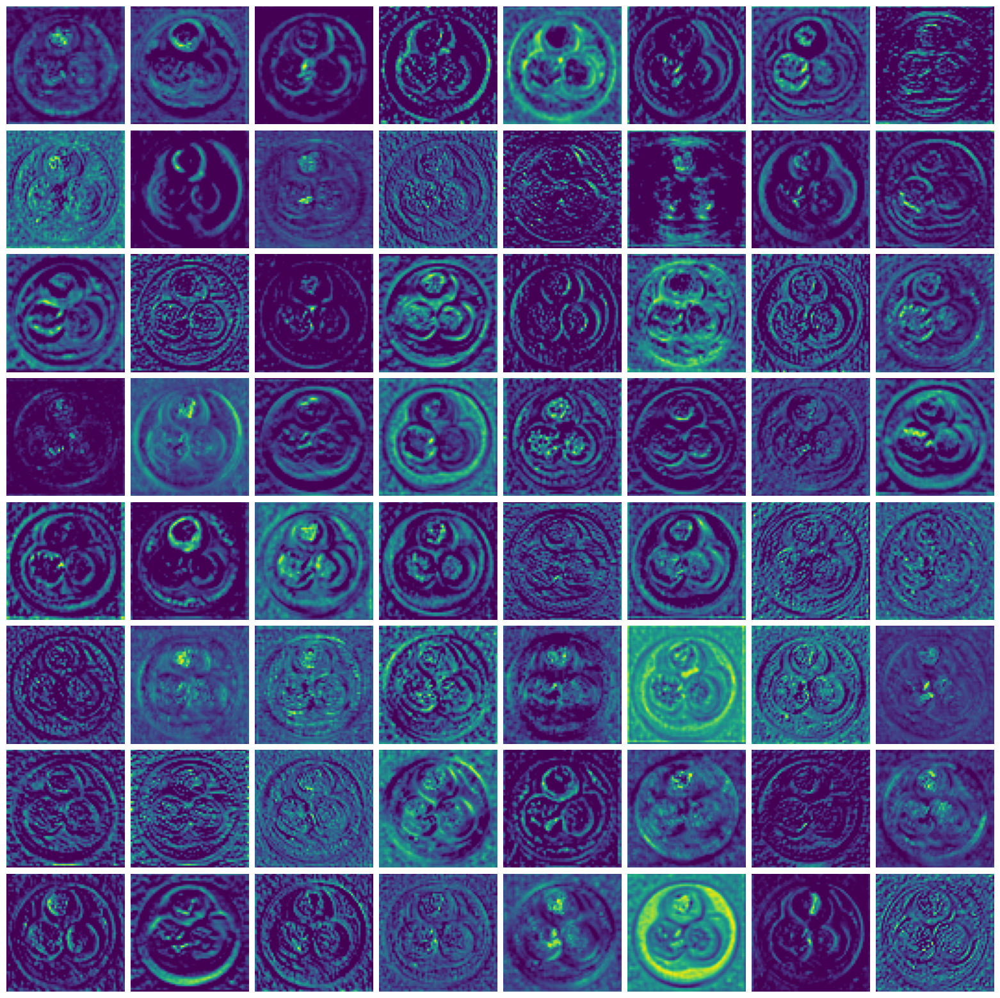

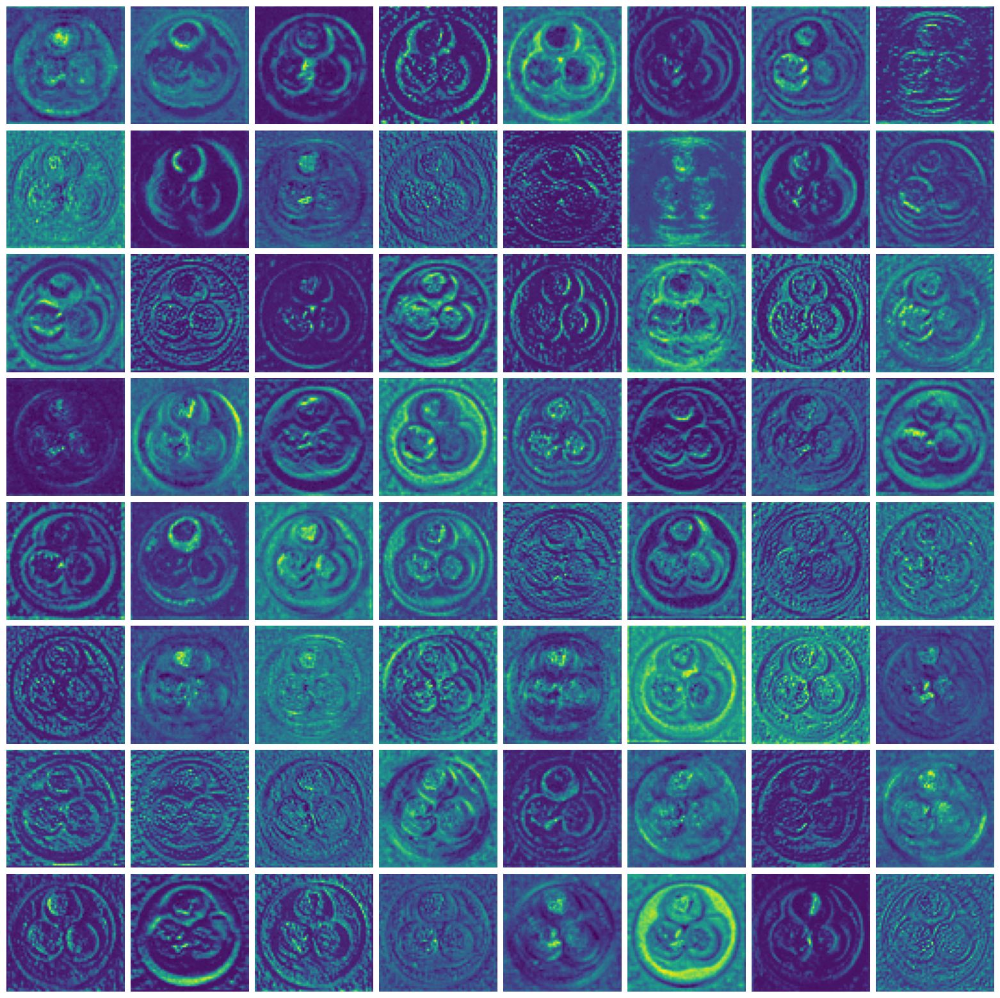

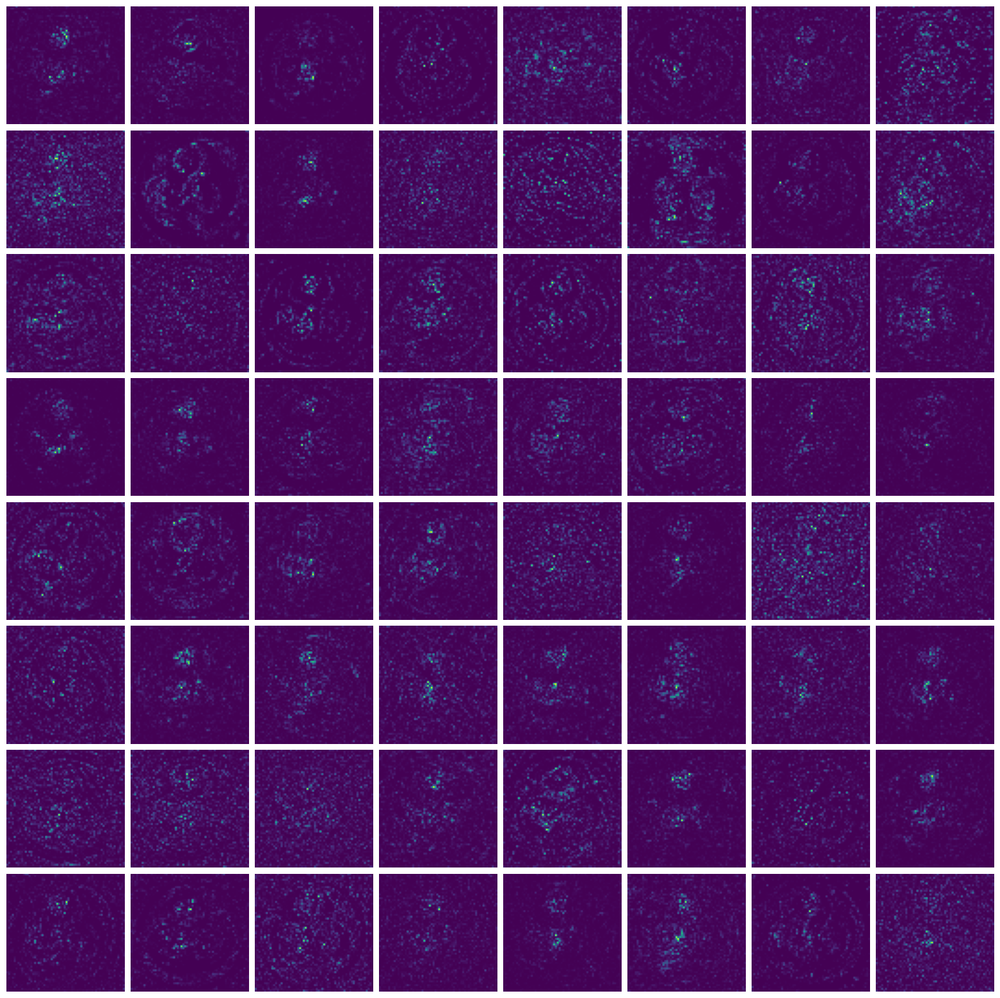

In [18]:
squared_diff=(resdict['featuremaps'][2][:,:,:,:].squeeze().cpu().numpy()-resdict['recons'][2][:,:,:,:].squeeze().cpu().numpy())**2
fig, axes = plt.subplots(1, 2, figsize=(10, 4))
axes[0].imshow(Image.open(resdict['paths'][2]))
axes[0].set_title('Anomaly test')
axes[0].axis('off')
axes[1].imshow(sum(squared_diff))
axes[1].set_title('Fmap-Reconstruction squared difference')
axes[1].axis('off')
plt.tight_layout(),plt.show()

plot_images(resdict['featuremaps'][2][:,:64,:,:].squeeze().cpu().numpy())
plot_images(resdict['recons'][2][:,:64,:,:].squeeze().cpu().numpy())
plot_images((resdict['featuremaps'][2][:,:64,:,:].squeeze().cpu().numpy()-resdict['recons'][2][:,:64,:,:].squeeze().cpu().numpy())**2)

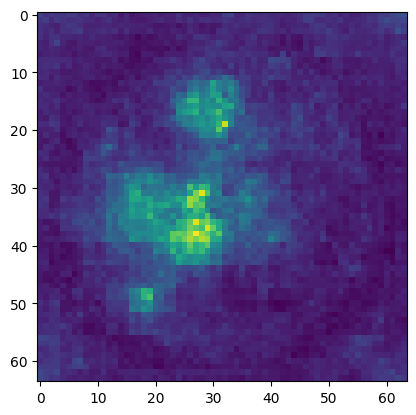

In [11]:
squared_diff=(resdict['featuremaps'][2][:,:,:,:].squeeze().cpu().numpy()-resdict['recons'][2][:,:,:,:].squeeze().cpu().numpy())**2



plt.imshow(sum(squared_diff))